In [1]:
# Add the DESC source code to the path, not necessary if you installed is as editable or as package
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../../"))

from desc import set_device
set_device("gpu")

In [2]:
import warnings
import numpy as np
np.set_printoptions(linewidth=np.inf, precision=4, suppress=True, threshold=sys.maxsize)
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go

In [3]:
import desc

from desc.backend import print_backend_info
from desc.examples import get
from desc.plotting import plot_3d, plot_particle_trajectories
from desc.particles import ManualParticleInitializerFlux, VacuumGuidingCenterTrajectory

print_backend_info()

DESC version=0.15.0+494.g65eddf2cc.
Using JAX backend: jax version=0.6.2, jaxlib version=0.6.2, dtype=float64.
Using device: NVIDIA A100-PCIE-40GB (id=0), with 40.00 GB available memory.


## Convert VMEC output to DESC Equilibrium Object

In [4]:
from desc.vmec import VMECIO
try:
    eq = desc.io.load("desc_LandremanPaul2021_QH_reactorScale_lowres_reference.h5")
except:
    eq = VMECIO.load("booz_xform/wout_LandremanPaul2021_QH_reactorScale_lowres_reference.nc", L=8, M=8, N=8, profile="current")
    eq.solve(maxiter=50);
    eq.save("desc_LandremanPaul2021_QH_reactorScale_lowres_reference.h5")

## Initial position of the particle

I ran the `boozer_to_cylindrical` function on given initial condition. Then, I mapped them to DESC computational coordinates $(\rho, \theta, \zeta)$.

```python
    rpz = np.array([R0, phi0, Z0])
    rtz = eq.map_coordinates(rpz, inbasis=("R", "phi", "Z"), outbasis=("rho", "theta", "zeta"))
```

In [5]:
p0 = np.loadtxt("init_coords_desc_rtz.txt")
print("Initial position of the particle in rho, theta, zeta coordinates : ", p0)

Initial position of the particle in rho, theta, zeta coordinates :  [0.7083 5.8192 0.5628]


## Import the converted Data

Suggested `boozer_to_cylindrical` function runs slow on single process. I distributed the trajectory data, and ran it in a job array on cluster (probably MPI could do this, but I am not familiar with how `booz_xform` uses the MPI). `brute-force.py` and `brute-force.slurm` are used to create these files. I gather the results in a single array here.

In [6]:
Rs = []
Zs = []
phis = []

for i in range(20):
    R = np.loadtxt(f"converted/R_job{i}_booz.txt")
    Z = np.loadtxt(f"converted/Z_job{i}_booz.txt")
    phi = np.loadtxt(f"converted/phi_job{i}_booz.txt")
    Rs.append(R)
    Zs.append(Z)
    phis.append(phi)
Rs = np.hstack(Rs)
Zs = np.hstack(Zs)
phis = np.hstack(phis)

Xs = Rs * np.cos(phis)
Ys = Rs * np.sin(phis)

## Plot the trajectory of FIRM3D

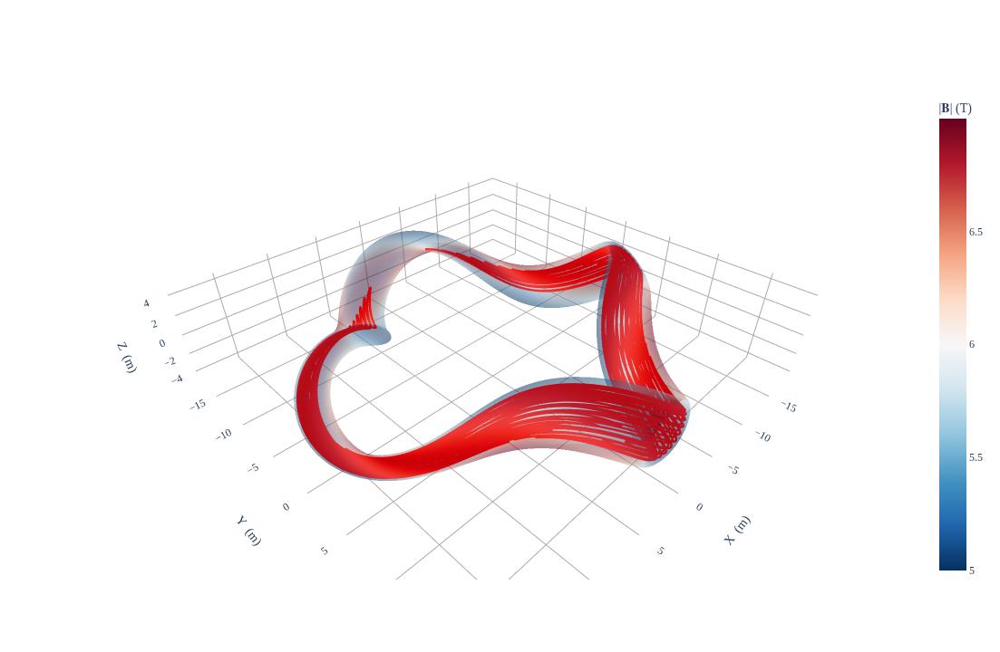

In [7]:
Np = Rs.size
# 3D plots use grid NFP=1 to plot all toroidal surfaces
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fig = plot_3d(eq, "|B|", alpha=0.3)
fig.add_trace(
    go.Scatter3d(
        x=Xs[:Np],
        y=Ys[:Np],
        z=Zs[:Np],
        mode="lines",
        line=dict(
            color="red",
            width=5,
            dash="solid",
        ),
        marker=dict(size=0),
        showlegend=False,
    )
)

## Create Particle and Trajectory Model Objects

In [28]:
model = VacuumGuidingCenterTrajectory(frame="flux")
particles = ManualParticleInitializerFlux(
    rho0=np.sqrt(0.5),
    theta0=p0[1],
    zeta0=p0[2],
    xi0=0.0,
)
ts = np.linspace(0, 1e-3, Np)

## Trace the particle and Plot both results

We will use the default tolerance for the particle tracing. This is equivalent to running the following,

```python
    iota = eq.get_profile("iota")
    params = eq.params_dict
    params["i_l"] = iota.params
    
    x, v = trace_particles(
        field=eq,
        initializer=particles,
        model=model,
        ts=ts,
        params=params,
        atol=1e-8,
        rtol=1e-8,
        min_step_size=1e-8,
        max_steps=1000000,
        solver=Tsit5(),
        adjoint=RecursiveCheckpointAdjoint(),
        chunk_size=None,
        options={"iota": iota},
    )
```

In [29]:
# original data in Boozer coordinates
traj_booz = np.loadtxt("run_firm3d/precise_QH/trajectory_data_tol_1e-10_resolution_96_tmax_0.001_trapped.txt")[:, 1:4]

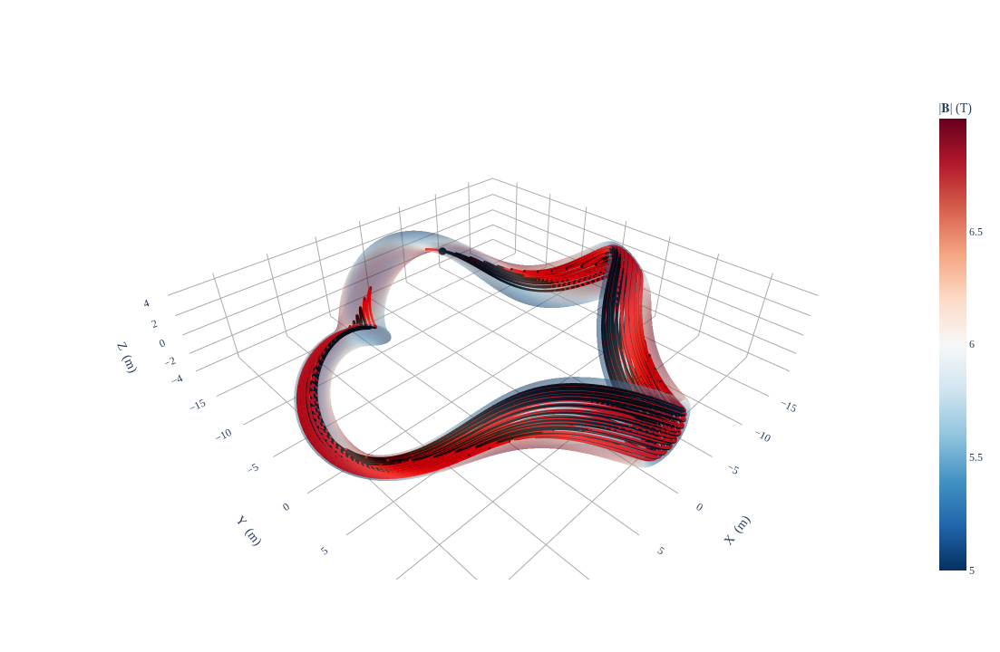

In [30]:
# 3D plots use grid NFP=1 to plot all toroidal surfaces
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fig = plot_3d(eq, "|B|", alpha=0.3)
fig, data = plot_particle_trajectories(
    eq,
    model,
    particles,
    ts=ts,
    max_steps=1000000, # upper limit for adaptive time stepping
    fig=fig,
    return_data=True,
)
fig.add_trace(
    go.Scatter3d(
        x=Xs[:Np],
        y=Ys[:Np],
        z=Zs[:Np],
        mode="lines",
        line=dict(
            color="red",
            width=5,
            dash="solid",
        ),
        marker=dict(size=0),
        showlegend=False,
    )
)

# Plots

In [31]:
def plot_comparison_traj(desc, firm3d):
    # Create a figure to host the subplots
    fig = plt.figure(figsize=(16, 10))
    # Use GridSpec for a more flexible layout
    gs = fig.add_gridspec(2, 2)
    
    # --- Top Plot (spanning the entire first row) ---
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(desc, label="DESC")
    ax1.plot(firm3d, label="FIRM3D")
    ax1.set_title("Full Data Comparison")
    ax1.legend()
    ax1.grid(True, linestyle='--', alpha=0.6)
    
    # --- Bottom-Left Plot (first 500 points) ---
    ax2 = fig.add_subplot(gs[1, 0])
    ax2.plot(desc[:500], label="DESC")
    ax2.plot(firm3d[:500], label="FIRM3D")
    ax2.set_title("Zoom on First 500 Points")
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.6)
    
    # --- Bottom-Right Plot (last 500 points) ---
    ax3 = fig.add_subplot(gs[1, 1])
    ax3.plot(desc[-500:], label="DESC")
    ax3.plot(firm3d[-500:], label="FIRM3D")
    ax3.set_title("Zoom on Last 500 Points")
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.6)

    return fig

## Real space R coordinate

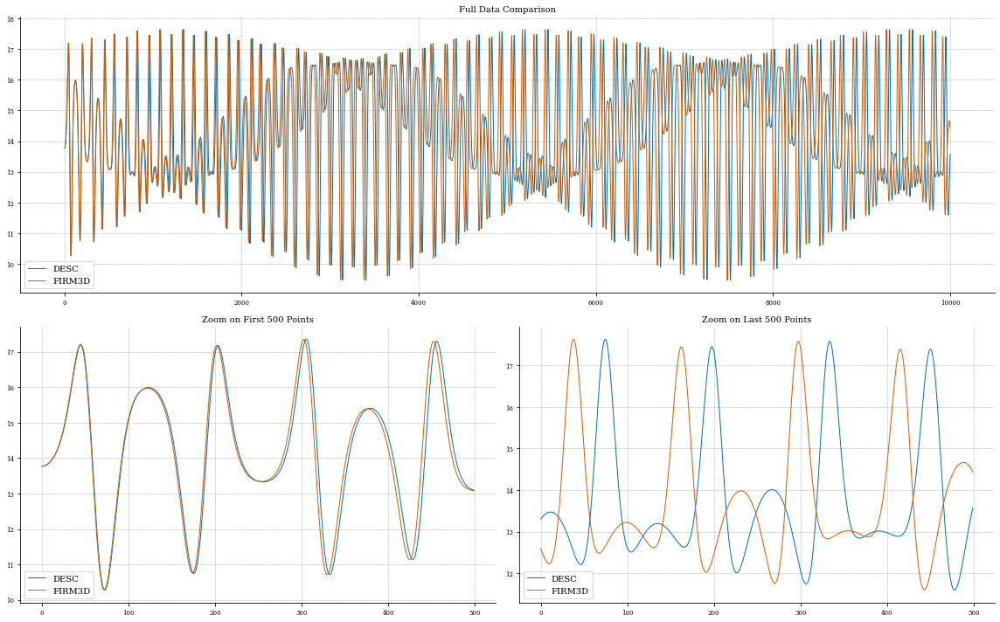

In [32]:
fig = plot_comparison_traj(data["R"][0], Rs)
# fig.savefig("compare_R_coord.png", dpi=1000)

## Real Space Z coordinate

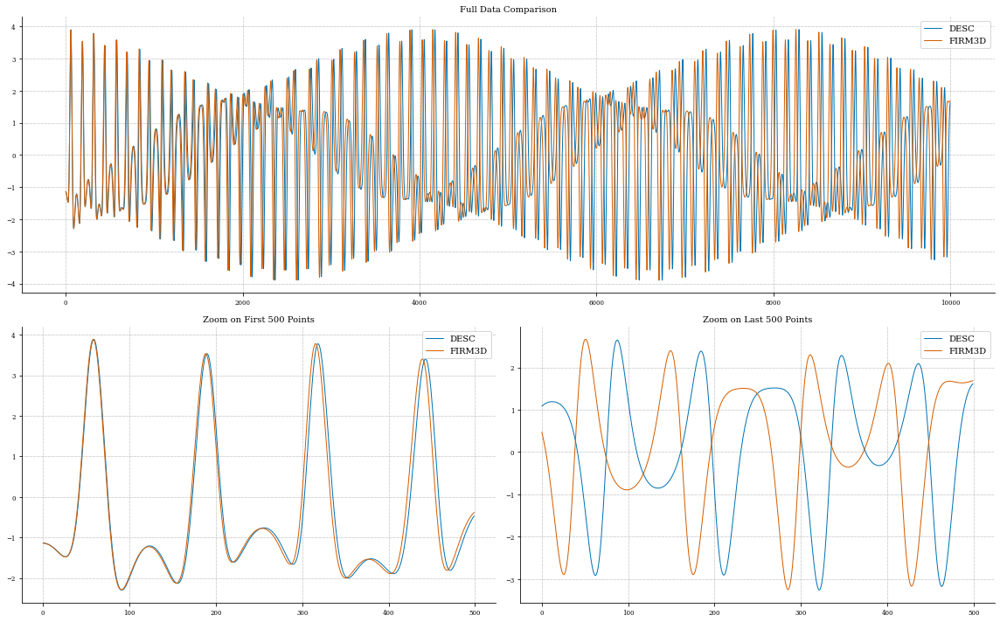

In [33]:
fig = plot_comparison_traj(data["Z"][0], Zs)
# fig.savefig("compare_Z_coord.png", dpi=1000)

## Real space phi coordinate

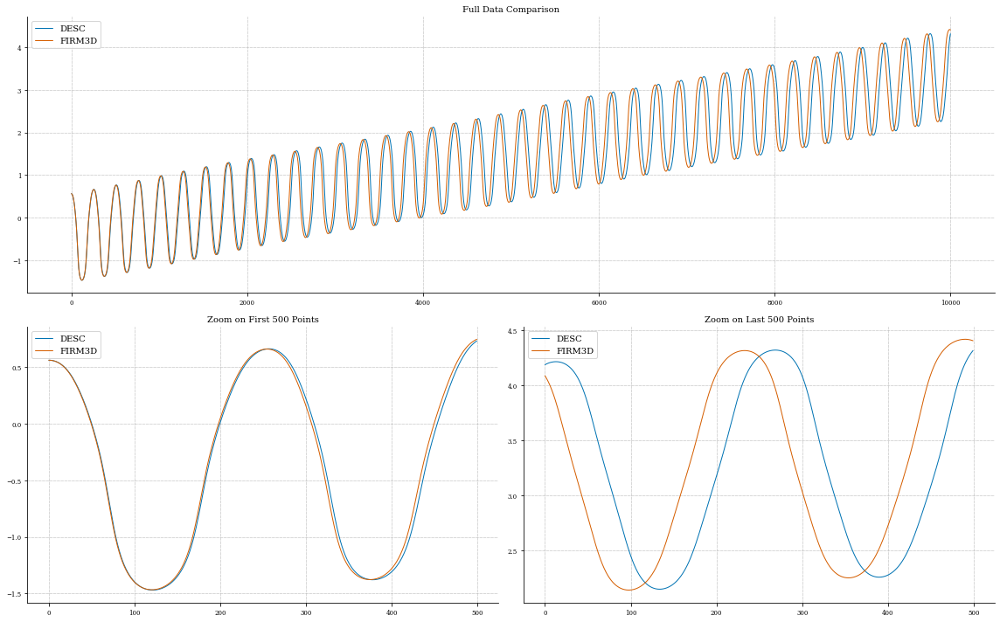

In [34]:
fig = plot_comparison_traj(data["phi"][0], phis)
# fig.savefig("compare_phi_coord.png", dpi=1000)

## Flux surface label s (=$\rho^2$)

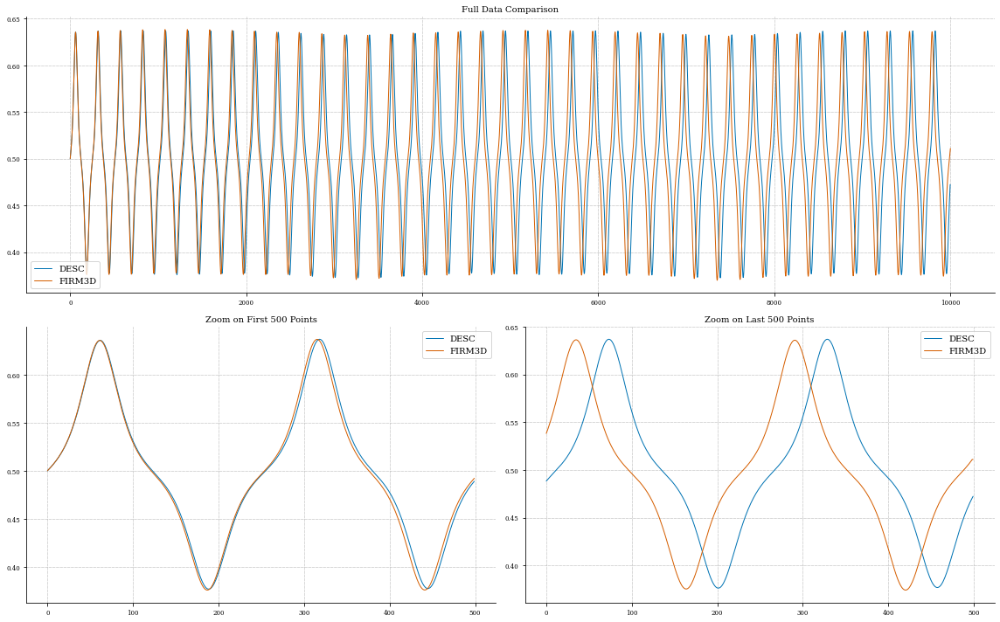

In [35]:
fig = plot_comparison_traj(data["rho"][0]**2, traj_booz[:, 0])
# fig.savefig("compare_s_coord.png", dpi=1000)

## Parallel Velocity

In [36]:
vpar_firm3d = np.loadtxt("run_firm3d/precise_QH/trajectory_data_tol_1e-10_resolution_96_tmax_0.001_trapped.txt")[:, 4]

In [37]:
from desc.particles import trace_particles
from diffrax import Tsit5, RecursiveCheckpointAdjoint

iota = eq.get_profile("iota")
params = eq.params_dict
params["i_l"] = iota.params

x, v = trace_particles(
    field=eq,
    initializer=particles,
    model=model,
    ts=ts,
    params=params,
    atol=1e-8,
    rtol=1e-8,
    min_step_size=1e-8,
    max_steps=1000000,
    solver=Tsit5(),
    adjoint=RecursiveCheckpointAdjoint(),
    chunk_size=None,
    options={"iota": iota},
)

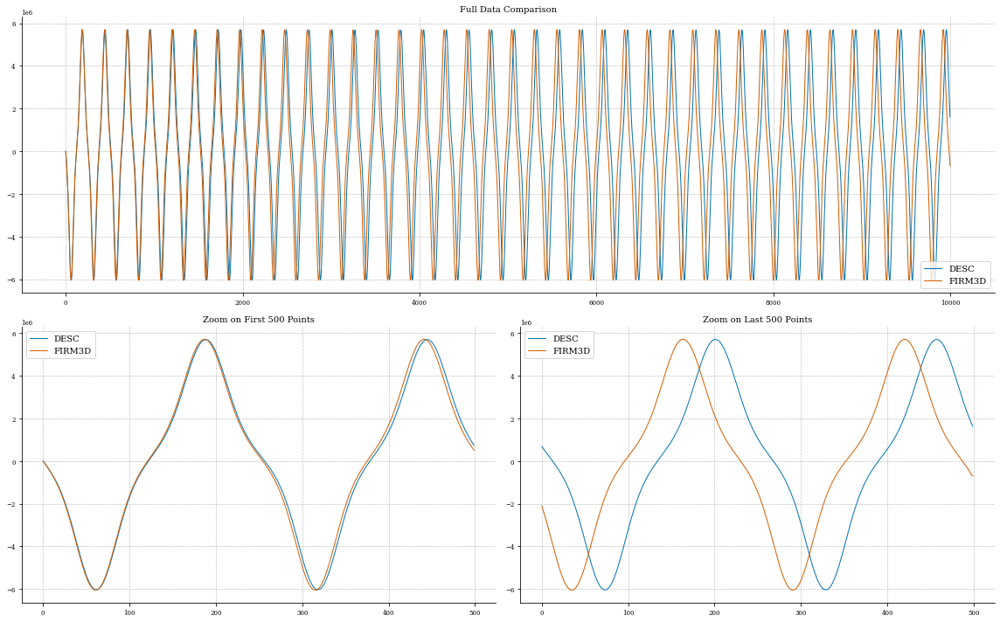

In [38]:
fig = plot_comparison_traj(v[0], vpar_firm3d)
# fig.savefig("compare_vpar.png", dpi=1000)